In [86]:
import librosa                            # Параметризация аудио
import numpy as np
import pandas as pd
import seaborn as sns
import librosa.display                    # Визуализация аудио
import matplotlib.pyplot as plt           # Отрисовка графиков
import IPython.display as ipd             # Проигрывание аудио в colab
import gdown                              # Загрузка датасетов из облака

# Нормирование сигнала
from sklearn.preprocessing import minmax_scale, scale

%matplotlib inline

from scipy.fft import rfft, rfftfreq
from scipy.fft import irfft
from scipy.io.wavfile import write
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

In [18]:
# Функция загрузки аудио и вывода текстовой информации
# о сигнале, а также проигрывателя аудио

def load_audio(audio_path, show_text=True, show_player=True ):
    # Загрузка аудиофайла, на выходе:
    # x  - массив данных временного ряда аудио
    # sr - частота дискретизации временного ряда
    x, sr = librosa.load(audio_path)

    if show_text:
        # Вывод текстовых данных о сигнале
        print(f'Типы данных x и sr: {type(x)}, {type(sr)}')
        print(f'Форма данных x: {x.shape}, sr = {sr}')
        print('Продолжительность сигнала:', round(x.shape[0]/sr), 'с.\n')

    if show_player:
        # Вывод проигрывателя в ячейку colab
        ipd.display(ipd.Audio(audio_path))

    # Возврат загруженных данных для дальнейшего использования
    return x, sr

In [151]:
path = 'D:\dissertation\codes\signal_processing_with_NN\\2022-02-01_14.36.14_8003019079_79637469273.mp3'
x, sr = load_audio(path)

Типы данных x и sr: <class 'numpy.ndarray'>, <class 'int'>
Форма данных x: (8383521,), sr = 22050
Продолжительность сигнала: 380 с.



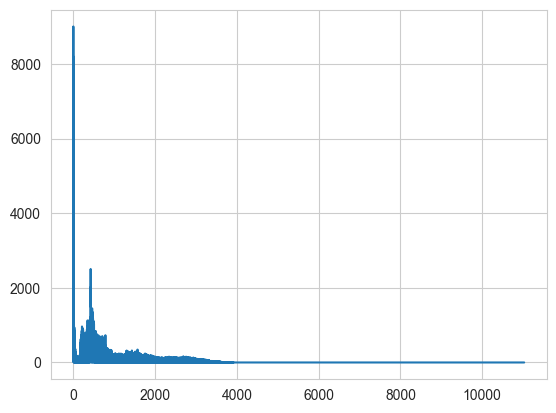

In [152]:
N = x.shape[0]
yf = rfft(x)
xf = rfftfreq(x.shape[0], 1/sr)
plt.plot(xf, np.abs(yf))
plt.show()

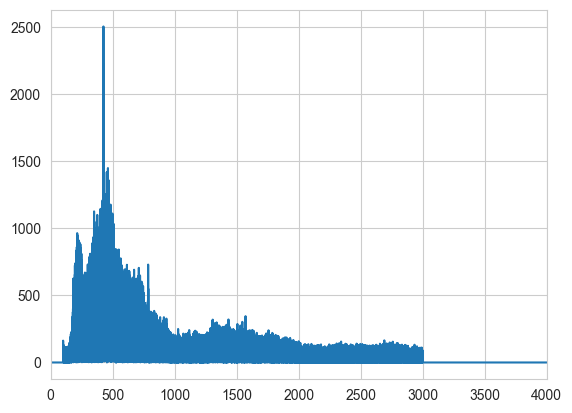

In [153]:
target_idx = int(100 * yf.shape[0] / (sr/2))
yf[:target_idx] = 0

target_idx = int(3000 * yf.shape[0] / (sr/2))
yf[target_idx:] = 0

plt.plot(xf, np.abs(yf))
plt.xlim([0,4000])
plt.show()

In [154]:
new_sig = irfft(yf)
# norm_new_sig = np.int16(new_sig * (32767 / new_sig.max()))
write("clean.wav", sr, new_sig)
ipd.display(ipd.Audio('D:\dissertation\codes\signal_processing_with_NN\clean.wav'))

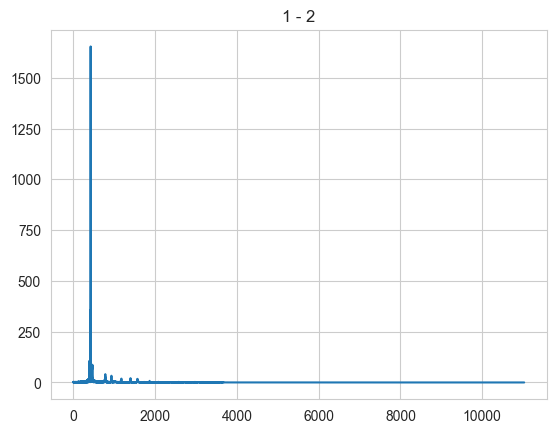

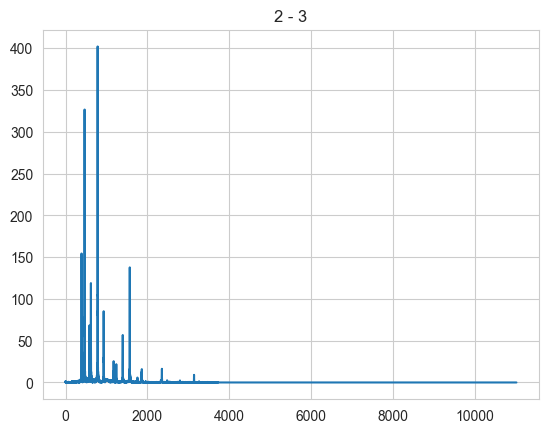

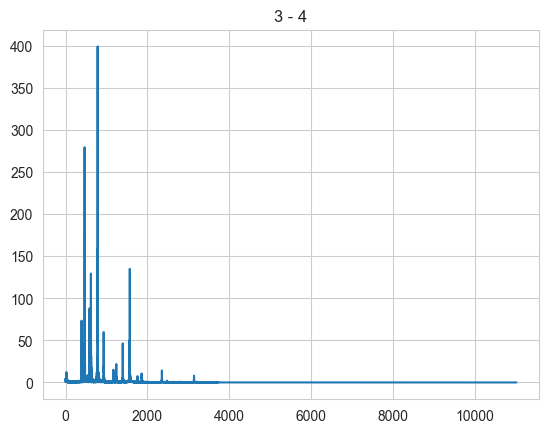

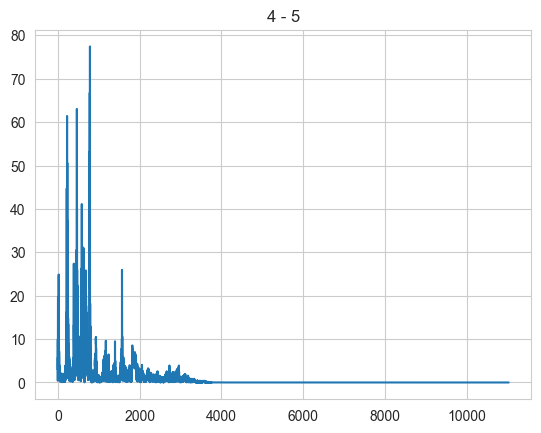

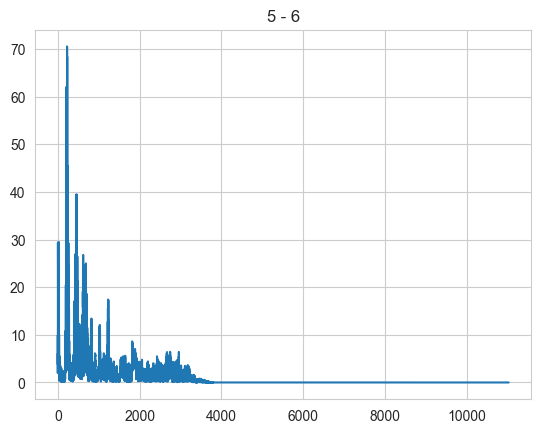

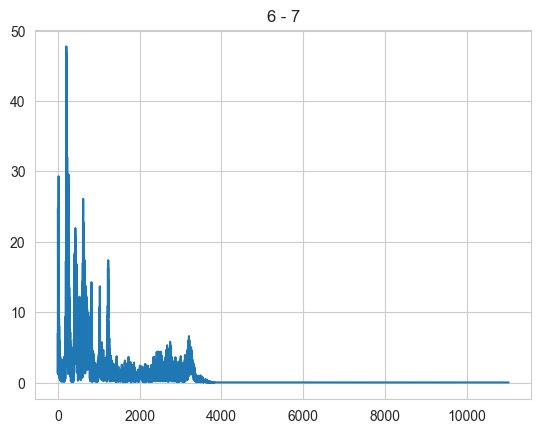

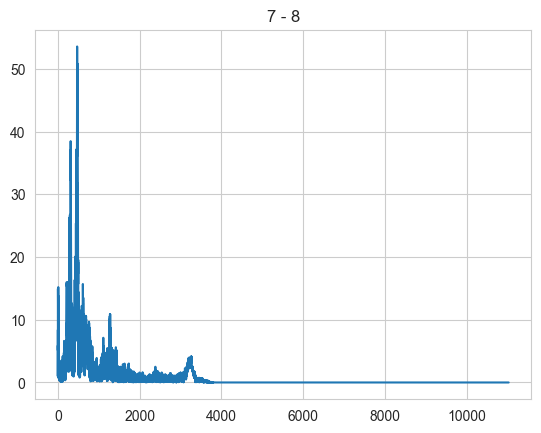

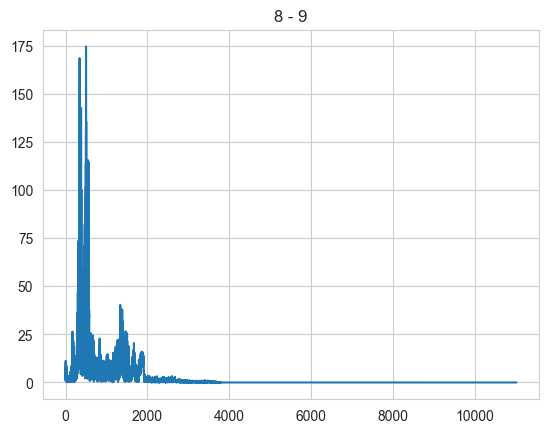

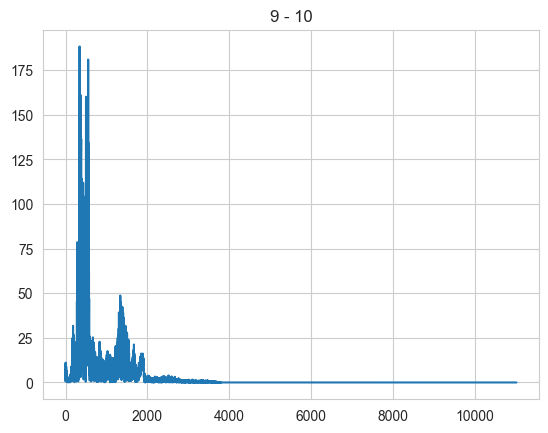

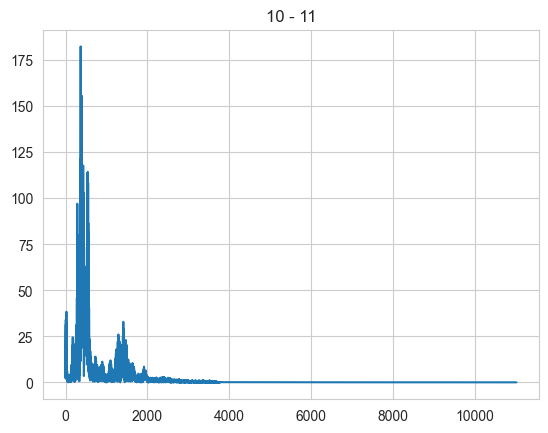

In [158]:
for i in range(0, 10):
    t = x[i * sr: (i+2) * sr]
    xf = rfftfreq(t.shape[0], 1/sr)
    yf = rfft(t)
    plt.plot(xf, np.abs(yf))
    plt.title(f'{i+1} - {i+2}')
    plt.show()

In [161]:
sig = [x[i:i + sr*2] for i in range(0, x.shape[0], sr)]
sig = sig[:-1]
yf_s = [rfft(i) for i in sig]
xf = rfftfreq(sig[0].shape[0], 1/sr)
v1 = 100
v2 = 3500
yf_s = [i[v1:v2] for i in yf_s]
yf_s = [np.abs(i) for i in yf_s]
yf_s = [i/i.max() for i in yf_s]
yf_s = np.array(yf_s)
xf = xf[v1:v2]
print(yf_s.shape)
print(xf.shape)

(380, 3400)
(3400,)


In [169]:
for i in range(yf_s.shape[1]):
    t = yf_s[:,i].flatten()
    yf_s[:,i] = np.where(t > t.median(), t, 0)

AttributeError: 'numpy.ndarray' object has no attribute 'median'

In [142]:
sig = [x[i:i + sr] for i in range(0, x.shape[0], sr)]
sig = sig[:-1]
yf_s = [rfft(i) for i in sig]
xf = rfftfreq(sig[0].shape[0], 1/sr)
#yf_s = np.array(yf_s)
#yf_s.shape

In [125]:
v1 = 100
v2 = 3500
yf_s = [i[v1:v2] for i in yf_s]
yf_s = [np.abs(i) for i in yf_s]
yf_s = [i/i.max() for i in yf_s]
yf_s = np.array(yf_s)
xf = xf[v1:v2]
print(yf_s.shape)
print(xf.shape)

(380, 3400)
(3400,)


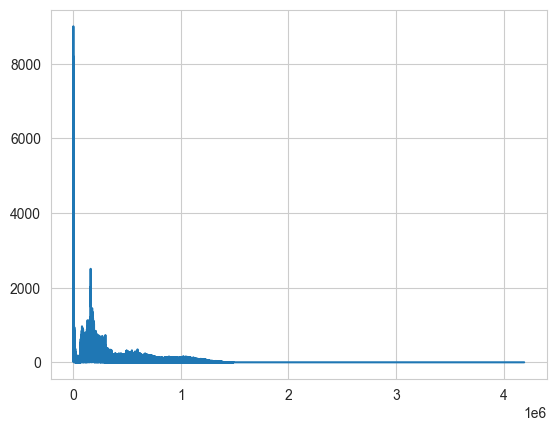

In [131]:
plt.plot(np.abs(rfft(x)))
plt.show()

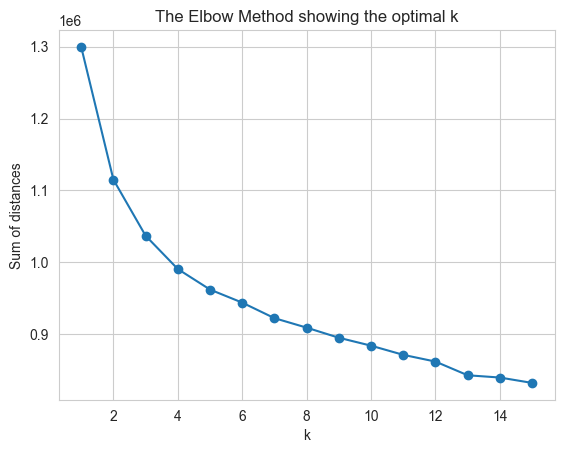

In [85]:
norm = MinMaxScaler()
norm = StandardScaler()
X = np.abs(yf_s)
norm.fit(X)
X = norm.transform(X)


K = range(1, 16)
models = [KMeans(n_clusters=k).fit(X) for k in K]
dist = [model.inertia_ for model in models]

# Plot the elbow
plt.plot(K, dist, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of distances')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [87]:
# Объект, в котором будет хранится информация о последовательном слиянии кластеров
link = linkage(X, 'ward', 'euclidean')

In [88]:
link[:5]

array([[ 24.        , 379.        ,   5.77918487,   2.        ],
       [307.        , 380.        ,   6.17307862,   3.        ],
       [372.        , 381.        ,   6.62141634,   4.        ],
       [ 56.        ,  58.        ,   8.00359123,   2.        ],
       [137.        , 382.        ,   8.33715406,   5.        ]])

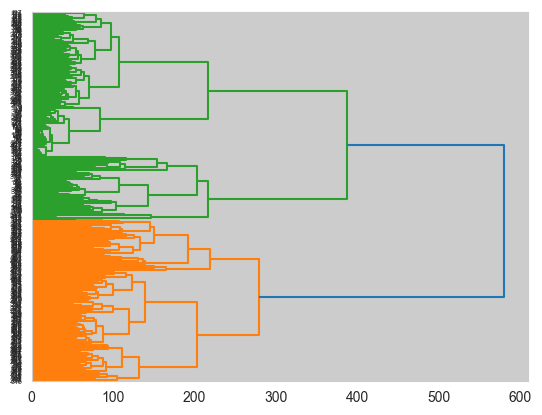

In [89]:
# Функция для построения дендрограммы
dn = dendrogram(link, orientation = "right")

In [91]:
# Останавливаем объединение, если расстояние между кластерами превышает 3
fcluster(link, 2, criterion='maxclust')

array([2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1,
       1, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 2, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2,
       1, 1, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1,
       2, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 2, 1,
       1, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 2, 1, 1, 1, 1, 1, 2, 2, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1,
       1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 1, 1, 2,
       1, 1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 2, 2,

In [97]:
t1 = 14
t2 = 20
temp = x[t1 * sr:t2 * sr]
# norm_new_sig = np.int16(new_sig * (32767 / new_sig.max()))
write("clean.wav", sr, temp)
ipd.display(ipd.Audio('D:\dissertation\codes\signal_processing_with_NN\clean.wav'))

In [171]:
import amfm_decompy.basic_tools as basic
import amfm_decompy.pYAAPT as pYAAPT
import matplotlib.pyplot as plt
import numpy as np
import sys


In [172]:
# load audio
signal = basic.SignalObj('D:\dissertation\codes\signal_processing_with_NN\clean.wav')


In [173]:
# YAAPT pitches
pitchY = pYAAPT.yaapt(signal, frame_length=40, tda_frame_length=40, f0_min=80, f0_max=1500)

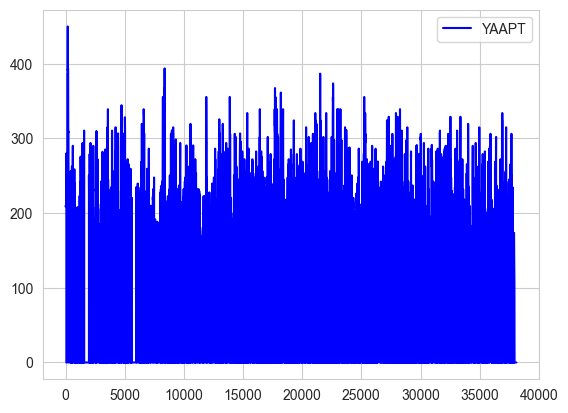

In [179]:
plt.plot(pitchY.samp_values, label='YAAPT', color='blue')
plt.legend()
plt.show()

In [180]:
pitchY.samp_values

array([209.05151367, 210.        , 210.        , ...,   0.        ,
         0.        ,   0.        ])